In [6]:
import os

import matplotlib.pyplot as plt
import seaborn as sns
import scanpy as sc
import numpy as np
import pandas as pd
from matplotlib.colors import LinearSegmentedColormap

### R interface to load the tumor data
import anndata2ri
from rpy2.robjects import r

anndata2ri.activate()
%load_ext rpy2.ipython

The rpy2.ipython extension is already loaded. To reload it, use:
  %reload_ext rpy2.ipython


/scratch/35341269/ipykernel_1500745/3224969304.py:18: DeprecationWarning: The global conversion available with activate() is deprecated and will be removed in the next major release. Use a local converter.
  anndata2ri.activate()


In [7]:
%reload_ext rpy2.ipython

In [5]:
%%R
.libPaths(c('/hpc/pmc_rios/2.personal/rariese/miniconda/envs/scanpy/lib/R/library',.libPaths()))

In [ ]:
%%R

library(Seurat)

In [ ]:
sc.settings.set_figure_params(dpi=70., transparent=True)
sc.settings.verbosity = 3
sc.settings.n_jobs = 3
sc.set_figure_params(vector_friendly=True,color_map='viridis',dpi_save=600,transparent=True)

plt.rcParams['figure.figsize']=(7,7)
sns.set_style("white")

fig_dir = '/hpc/pmc_rios/2.personal/rariese/scseq_analysis/BRO/tumor/figures/'

In [9]:
def compute_jaccard_similarity(adata, annotation1, annotation2):
    """
    Compute the Jaccard similarity between two cluster annotations in an AnnData object.
    
    Parameters:
        adata (AnnData): The AnnData object containing the annotations.
        annotation1 (str): The key in `adata.obs` for the first annotation.
        annotation2 (str): The key in `adata.obs` for the second annotation.
    
    Returns:
        pd.DataFrame: A DataFrame where entry (i, j) is the Jaccard similarity
                      between cluster i in annotation1 and cluster j in annotation2.
    """
    # Extract the annotations
    clusters1 = adata.obs[annotation1]
    clusters2 = adata.obs[annotation2]

    # Get unique cluster labels
    unique1 = clusters1.unique()
    unique2 = clusters2.unique()

    # Initialize the Jaccard similarity matrix
    jaccard_matrix = np.zeros((len(unique1), len(unique2)))

    # Compute Jaccard similarity for each pair of clusters
    for i, cluster1 in enumerate(unique1):
        set1 = set(adata.obs.index[clusters1 == cluster1])
        for j, cluster2 in enumerate(unique2):
            set2 = set(adata.obs.index[clusters2 == cluster2])
            intersection = len(set1 & set2)
            union = len(set1 | set2)
            jaccard_matrix[i, j] = intersection / union if union > 0 else 0.0

    # Convert to a DataFrame for easier interpretation
    jaccard_df = pd.DataFrame(
        jaccard_matrix,
        index=[f"{label}" for label in unique1],
        columns=[f"{label}" for label in unique2]
    )

    return jaccard_df

def generate_new_sample_names(row, counter_dict):
    run_id = row['RunID']
    sample = row['sample']
    
    if (run_id, sample) not in counter_dict:
        counter_dict[(run_id, sample)] = 0
    else:
        counter_dict[(run_id, sample)] += 1

    suffix = chr(97 + counter_dict[(run_id, sample)])  # 'a', 'b', 'c', etc.
    return f"{run_id}_{suffix}"

In [10]:
palette_tumorstate = {
    "AC-like":"#f2cc8f",
    "MES-like":"#e07a5f",
    "OPC-like-1":"#5f797b",
    "OPC-like-2":"#3d405b",
    "OPC-like-3":"#81b29a",
    "Cycling":"#f4f1de",
}

days_color = {
    "71":"#3d5a80",
    "131":"#98c1d9"
}

cc_colors = {
    'G1':'#faf0ca',
    'S':'#f4d35e',
    'G2M':'#0d3b66'
}

cnv_colors = {
    "aneuploid":"#00f59b",
    "diploid":"#7014f2",
    "not.defined":"#D3D3D3"
}

annot_level_2_color = {
    'PSC':'#c2d6c2', #d5573b',
    'Radial glia':'#f2ae54', #ce336e',
    'Neuroepithelium':'#f5d1a3',
    'OPC':'#0077b6',#11b8ea
    'Pre-OPC':'#48cae4',#11b8ea
    'COP':'#03045e',#11b8ea
    'Neuron':'#006400', #38d373',
    'Neuroblast':'#38b000', #38d373',
    'Neuronal IPC':'#70e000', #38d373',
    #'OPC':'#ff7240', #9c4fff',
    'Glioblast':'#e01e37', #ffbe15',
    'Astrocyte':'#85182a', #2073ff',
    'Fibroblast':'#D3D3D3',
    'Neural crest':'#8c8c8c',
}

In [11]:
tumor_path = "/hpc/pmc_rios/2.personal/rariese/scseq_analysis/BRO/tumor/data/BRO_tumor/BRO_tumor_t12_no_sn_annot.h5ad"
lineage_path = "/hpc/pmc_rios/2.personal/rariese/scseq_analysis/BRO/tumor/data/BRO_tumor/BRO_tumor_t12_no_sn_annot_lineage.rds"

In [12]:
adata = sc.read_h5ad(tumor_path)
adata

AnnData object with n_obs × n_vars = 6788 × 14747
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'sample', 'nCount_HTO', 'nFeature_HTO', 'percent.mito', 'percent.ribo', 'gender.score1', 'gender.score2', 'gender.score3', 'gender.score4', 'gender.score5', 'nCount_SCT', 'nFeature_SCT', 'seurat_clusters', 'DF.individual', 'DF.pANN.individual', 'G1.S.score_Neftel', 'G2.M.score_Neftel', 'S.Score', 'G2M.Score', 'Phase', 'source', 'RunID', 'tumor.score', 'gender.score', 'nCount_prediction.score.type', 'nFeature_prediction.score.type', 'RunID.sample', 'RunID.source', 'sample.source', 'RNA_snn_res.0.4', 'RNA_snn_res.0.8', 'RNA_snn_res.1.2', 'names', 'tumor.plasmids', 'tumor.plasmids.malignancy.25', 'annotation.Liu', 'RNA_snn_res.0.8_mod', 'ident', 'Day', 'percent.mt', 'percent.rb', 'old.ident', 'CC.Difference', 'Group', 'percent.MT', 'cancer_nils', 'batch', 'singlets', 'RNA_snn_res.0', 'RNA_snn_res.0.2', 'RNA_snn_res.0.6', 'RNA_snn_res.1', 'RNA_snn_res.1.4', 'RNA_snn_res.1.6', 'RNA_snn_res

In [13]:
new_names = {
    "A0251": "DMGO_batch1_a",
    "A0254": "DMGO_batch1_b",
    "A0256": "DMGO_batch1_c",
    "A0257": "DMGO_batch1_d",
    "A0258": "DMGO_batch1_e",
    "A0260": "DMGO_batch1_f",
    "A0264": "DMGO_batch1_g",
    "T1-2-H9-1": "DMGO_batch2_a",
    "ISorCtlTra_1": "DMGO_batch3_a",
    "ISorCtlTra_2": "DMGO_batch3_b",
    "ISorNoTcTra": "DMGO_batch3_c",
    "T1.5-2-H9-7": "DMGO_batch4_a",
    "T2-2-H9-2": "DMGO_batch4_b",
    "T2-2-H9-4": "DMGO_batch4_c",
    }

# Map the values in the 'sample' column using the dictionary
adata.obs['sample'] = adata.obs['sample'].map(new_names).astype('category')

In [14]:
new_names = {
    "DMGO_t1_1": "DMGO_batch1",
    "DMGO_t1_2": "DMGO_batch2",
    "DMGO_t2_1": "DMGO_batch3",
    "DMGO_t2_2": "DMGO_batch4",
    }

# Map the values in the 'sample' column using the dictionary
adata.obs['RunID'] = adata.obs['RunID'].map(new_names)

In [15]:
adata.obs['nFeature_RNA'] = adata.obs['nFeature_RNA'].astype(float)
adata.obs['nCount_RNA'] = adata.obs['nCount_RNA'].astype(float)
adata.obs['percent.mito'] = adata.obs['percent.mito'].astype(float)
adata.obs['percent.ribo'] = adata.obs['percent.ribo'].astype(float)

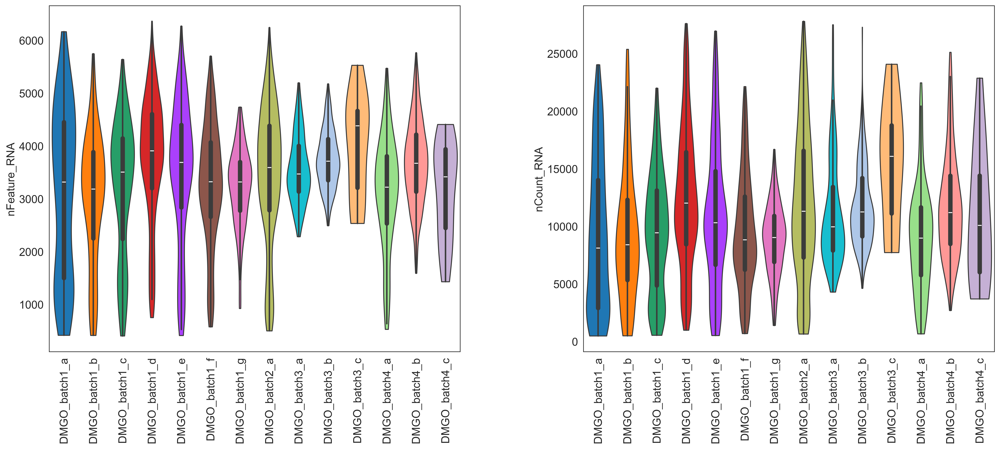

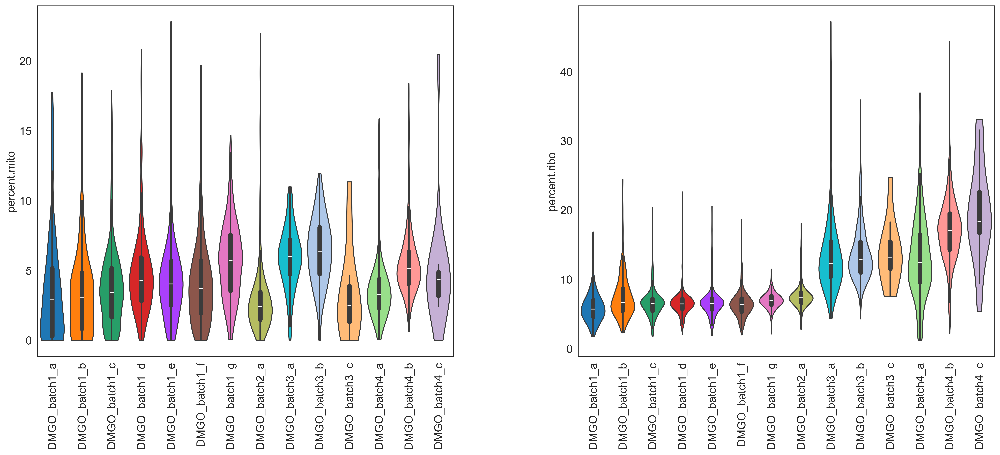

In [38]:
with plt.rc_context({"figure.figsize": (8,8), "figure.dpi": (300)}):
    sc.pl.violin(adata, keys=['nFeature_RNA','nCount_RNA'], groupby='sample', inner = 'box',stripplot = False, saturation=1, show=False, rotation=90)
    plt.savefig(os.path.join(fig_dir, "Violin_QC_plots_1.pdf"), bbox_inches="tight")

    sc.pl.violin(adata, keys=['percent.mito','percent.ribo'], groupby='sample', inner = 'box', stripplot = False, saturation=1, show=False, rotation=90)
    plt.savefig(os.path.join(fig_dir, "Violin_QC_plots_2.pdf"), bbox_inches="tight")

### Integrate datasets

In [46]:
sc.external.pp.harmony_integrate(adata, 'RunID', adjusted_basis="X_pca",  max_iter_harmony=20)

2025-05-13 11:58:21,593 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...


2025-05-13 11:58:26,098 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-05-13 11:58:26,129 - harmonypy - INFO - Iteration 1 of 20
2025-05-13 11:58:28,846 - harmonypy - INFO - Iteration 2 of 20
2025-05-13 11:58:29,878 - harmonypy - INFO - Iteration 3 of 20
2025-05-13 11:58:31,084 - harmonypy - INFO - Converged after 3 iterations


In [21]:
sc.pp.neighbors(adata, use_rep="X_pca", n_neighbors=100, n_pcs=15)

/hpc/pmc_rios/2.personal/rariese/miniconda/envs/scanpy/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [22]:
sc.tl.diffmap(adata)

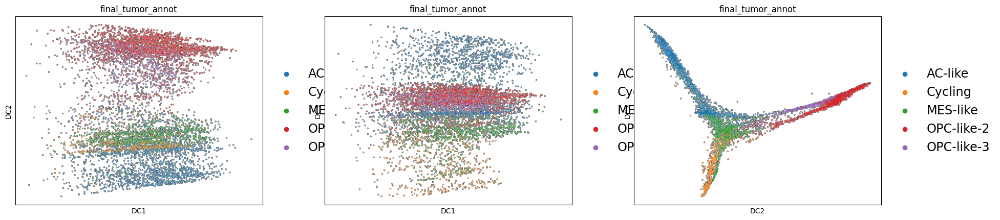

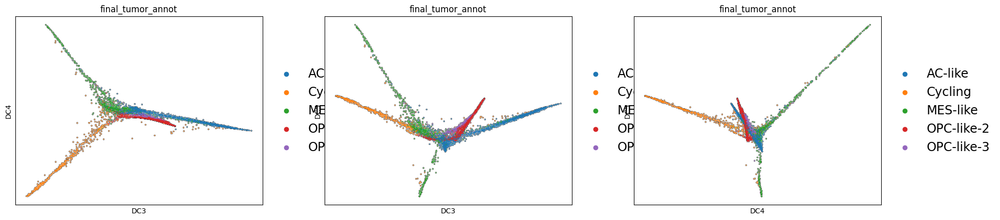

In [23]:
sc.pl.diffmap(adata, color='final_tumor_annot',components=['1,2','1,3','2,3'], size = 10,add_outline=True, outline_width=(0.2, 0.05), legend_fontsize = "xx-large")
sc.pl.diffmap(adata, color='final_tumor_annot',components=['3,4','3,5','4,5'], size = 10,add_outline=True, outline_width=(0.2, 0.05), legend_fontsize = "xx-large")

In [24]:
sc.tl.draw_graph(adata, n_jobs=4, )

[<Axes: title={'center': 'final_tumor_annot'}, xlabel='FA1', ylabel='FA2'>,
 <Axes: title={'center': 'Day'}, xlabel='FA1', ylabel='FA2'>]

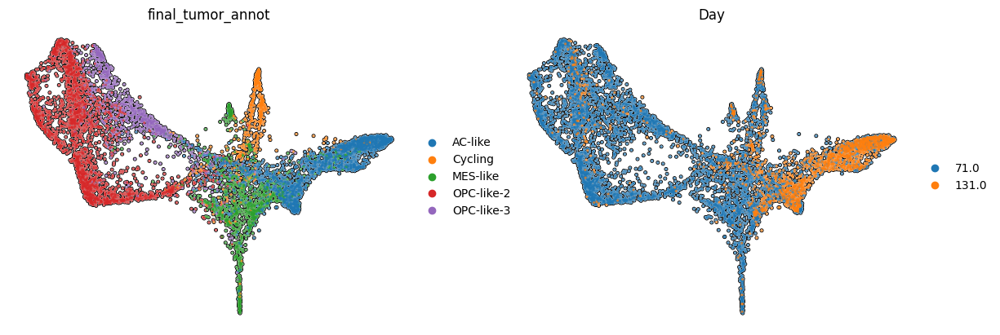

In [25]:
sc.pl.draw_graph(adata, color=['final_tumor_annot','Day'], size=20, add_outline=True, outline_width=(0.3,0.0), frameon=False, show=False)

### Plots

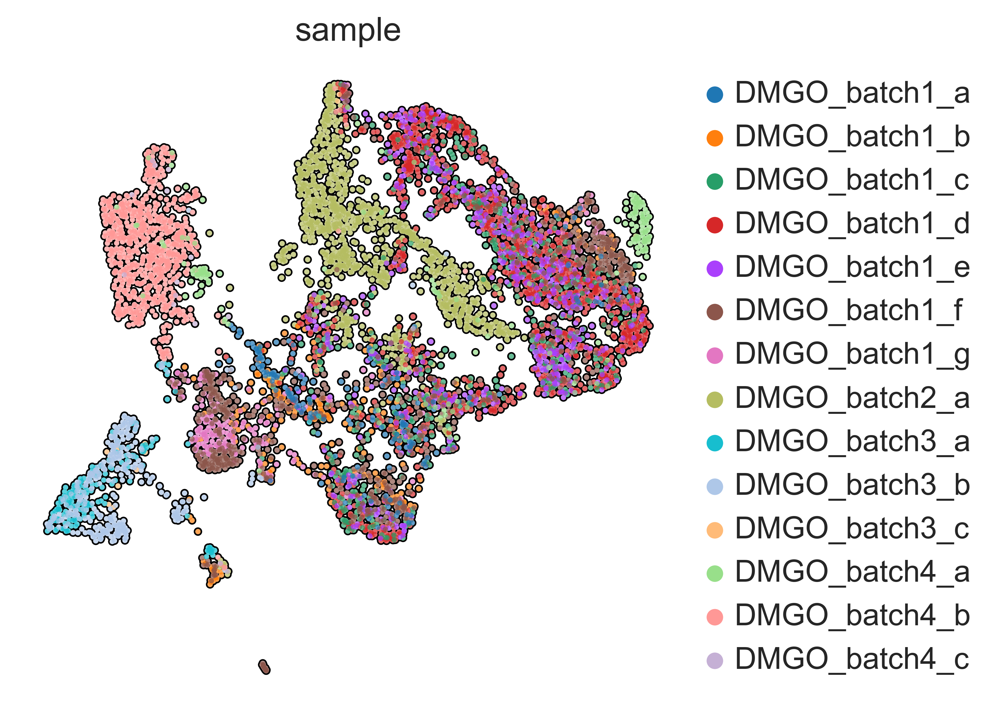

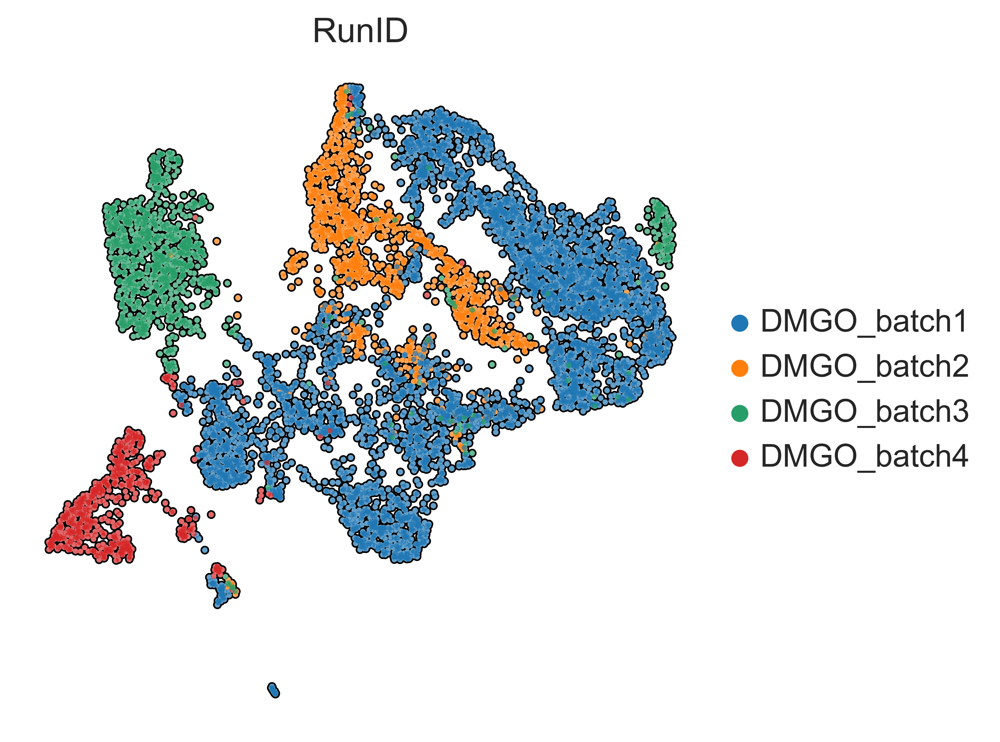

In [41]:
with plt.rc_context({"figure.figsize": (5,5), "figure.dpi": (300)}):
    sc.pl.embedding(adata, basis='X_umap', color=['sample'], size=20, add_outline=True, outline_width=(0.3,0.0), frameon=False, show=False)
    plt.savefig(os.path.join(fig_dir,"UMAP_unintegrated_sample.pdf"), bbox_inches="tight")
    sc.pl.embedding(adata, basis='X_umap', color=['RunID'], size=20, add_outline=True, outline_width=(0.3,0.0), frameon=False, show=False)
    plt.savefig(os.path.join(fig_dir,"UMAP_unintegrated_RunID.pdf"), bbox_inches="tight")

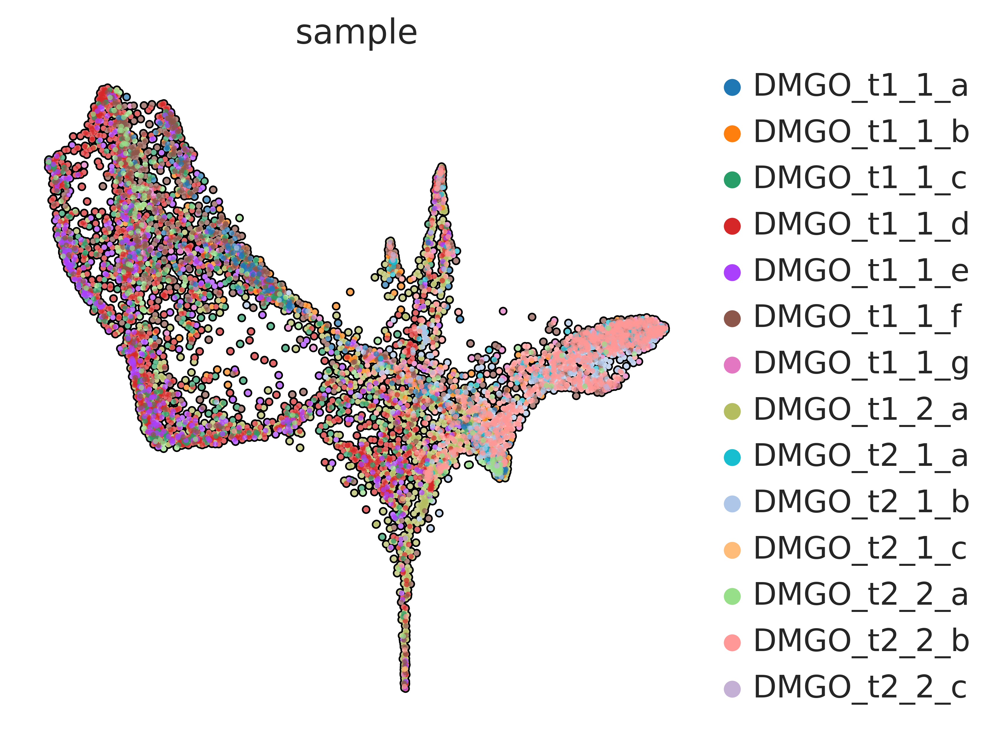

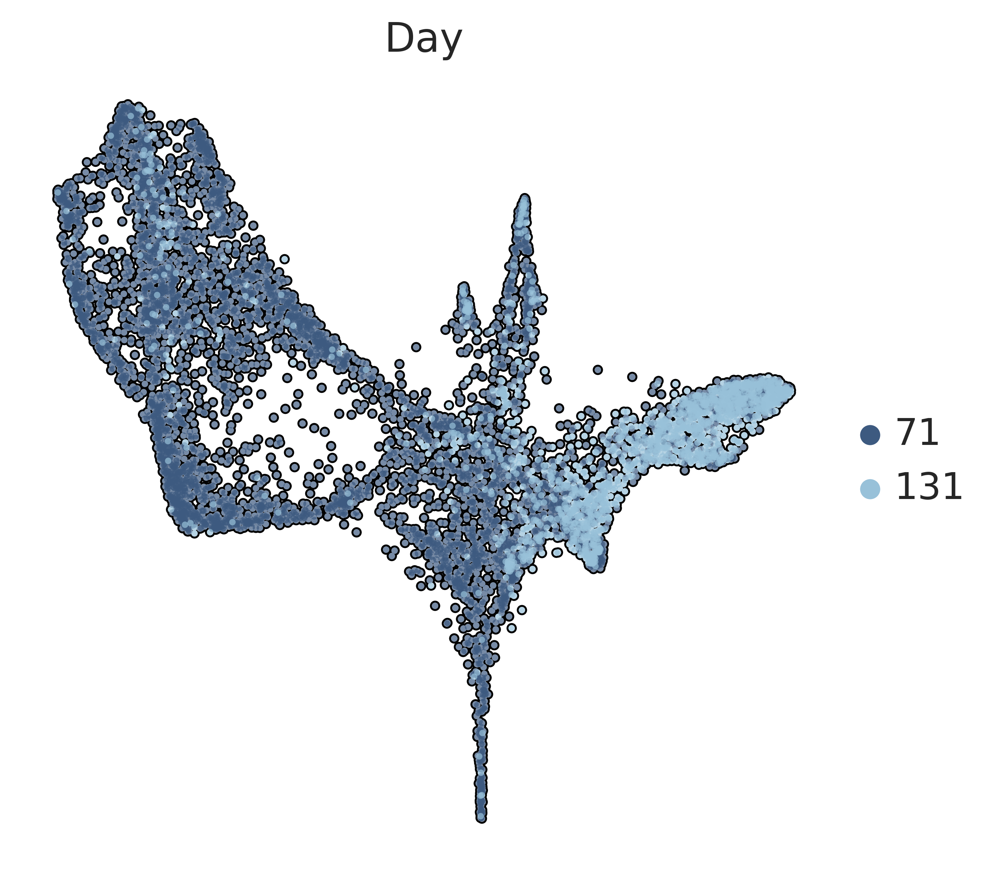

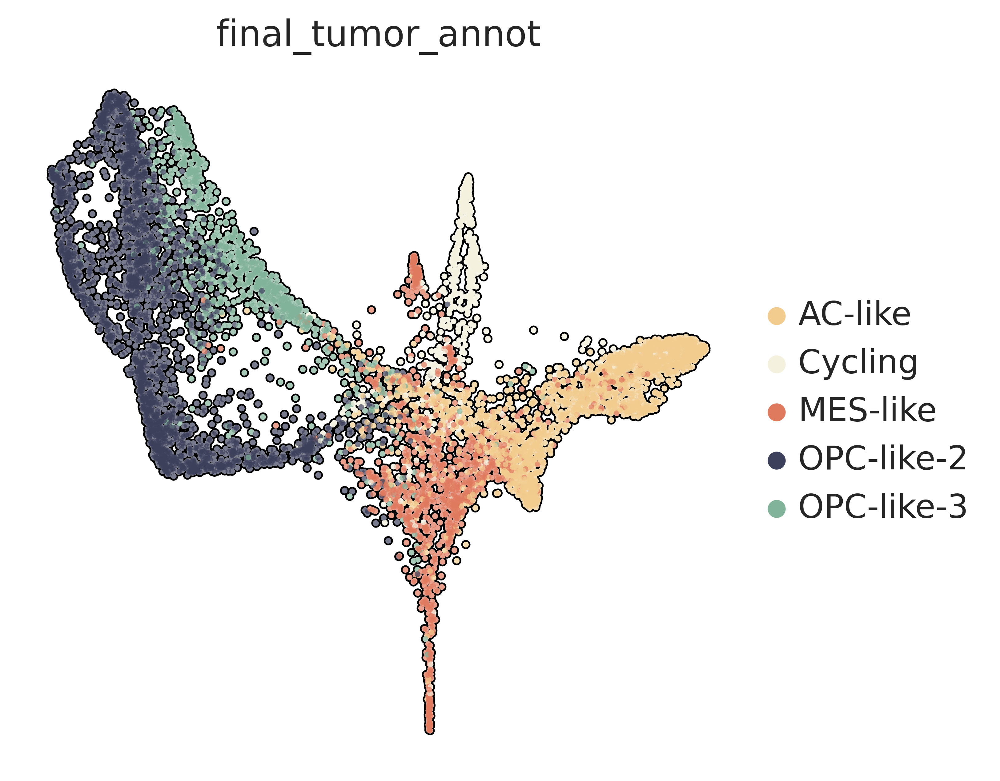

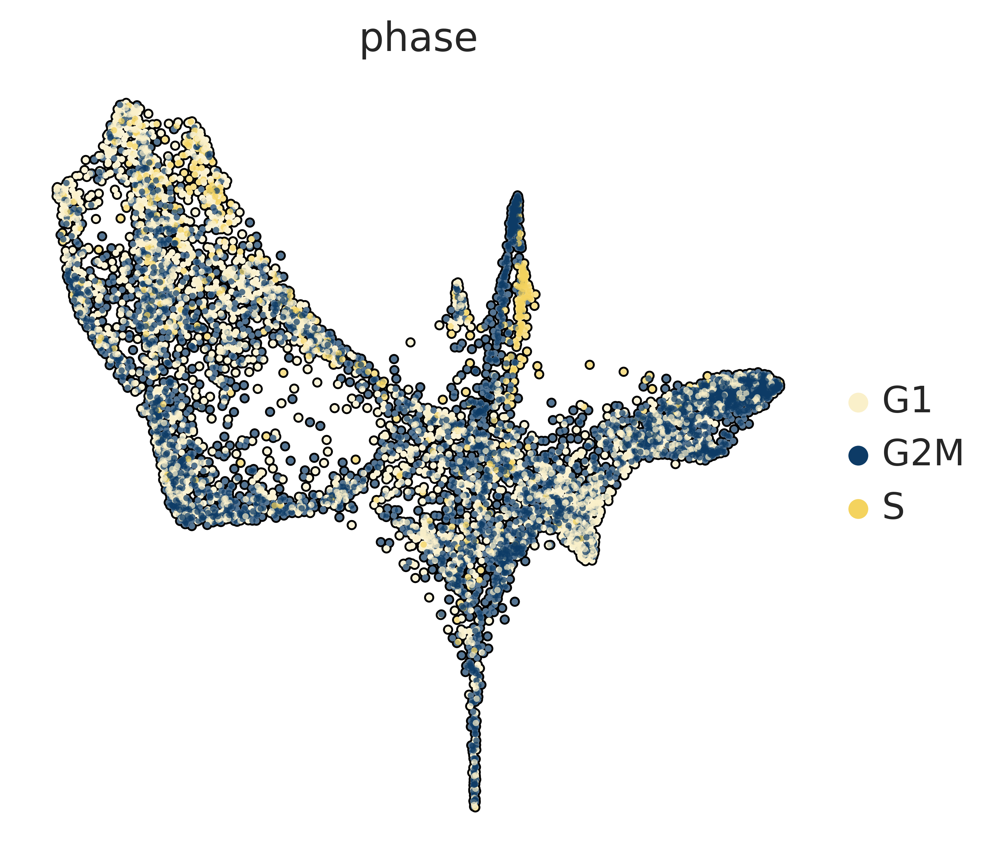

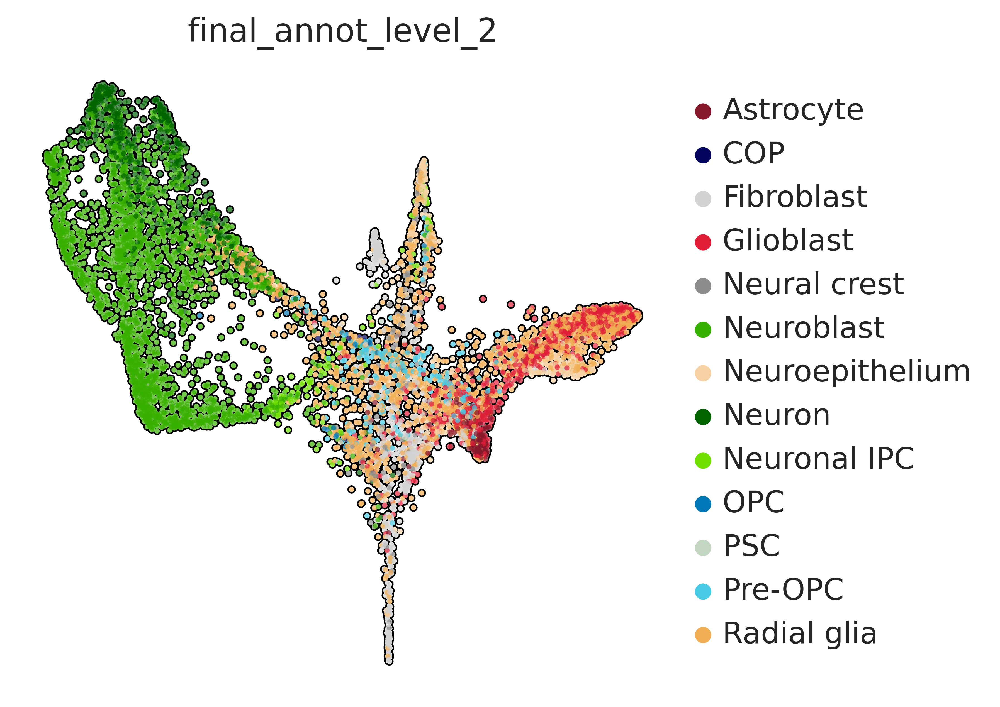

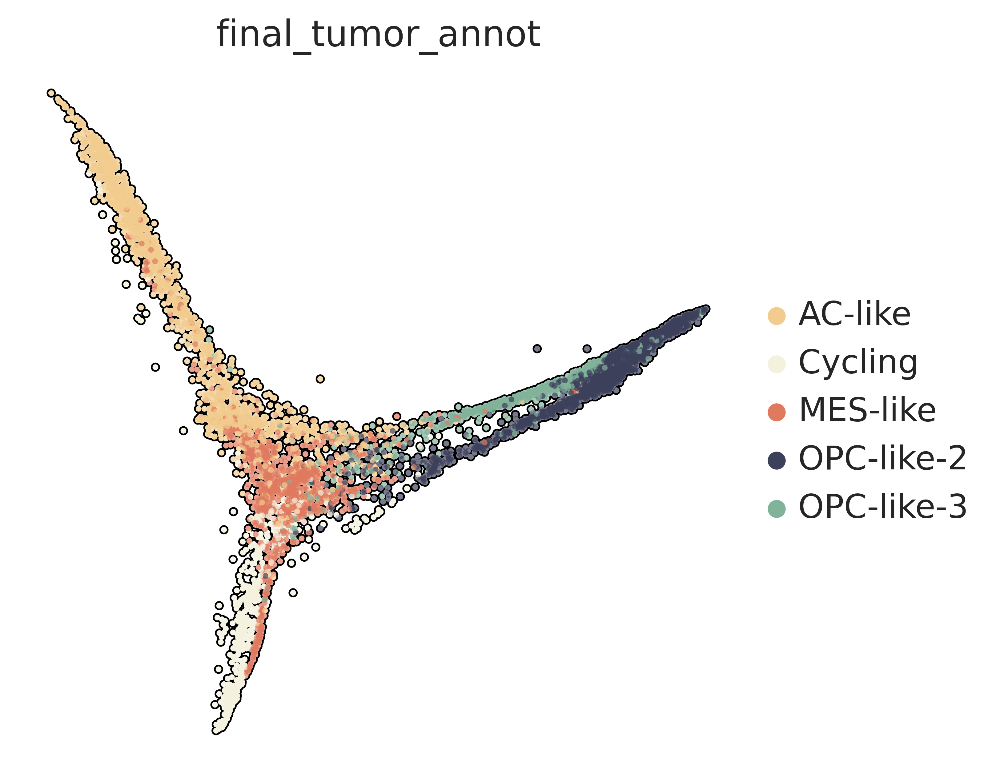

In [132]:
with plt.rc_context({"figure.figsize": (5,5), "figure.dpi": (300)}):
    sc.pl.embedding(adata, basis='X_draw_graph_fa', color=['sample'], size=20, add_outline=True, outline_width=(0.3,0.0), frameon=False, show=False)
    plt.savefig(os.path.join(fig_dir,"UMAP_sample.pdf"), bbox_inches="tight")

    sc.pl.embedding(adata, basis='X_draw_graph_fa', color=['Day'], size=20, add_outline=True, outline_width=(0.3,0.0), frameon=False, palette=days_color, show=False)
    plt.savefig(os.path.join(fig_dir,"UMAP_days.pdf"), bbox_inches="tight")

    sc.pl.embedding(adata, basis='X_draw_graph_fa', color=['final_tumor_annot'], size=20, add_outline=True, outline_width=(0.3,0.0), frameon=False, palette=palette_tumorstate, show=False)
    plt.savefig(os.path.join(fig_dir,"UMAP_final_tumor_annot.pdf"), bbox_inches="tight")

    sc.pl.embedding(adata, basis='X_draw_graph_fa', color=['phase'], size=20, add_outline=True, outline_width=(0.3,0.0), frameon=False, palette=cc_colors, show=False)
    plt.savefig(os.path.join(fig_dir,"UMAP_cc_phase.pdf"), bbox_inches="tight")

    sc.pl.embedding(adata, basis='X_draw_graph_fa', color=['final_annot_level_2'], size=20, add_outline=True, outline_width=(0.3,0.0), frameon=False, palette=annot_level_2_color, show=False)
    plt.savefig(os.path.join(fig_dir,"UMAP_final_annot_level_2.pdf"), bbox_inches="tight")

    sc.pl.embedding(adata, basis='X_diffmap', color=['final_tumor_annot'], size=20, components=['2,3'], add_outline=True, outline_width=(0.3,0.0), frameon=False, show=False)
    plt.savefig(os.path.join(fig_dir,"diffmap_final_tumor_annot.pdf"), bbox_inches="tight")


In [17]:
genes_dict = {
    "Cycling":["MKI67","TOP2A","UBE2C"],
    "OPC-like-2":["NNAT","PCP4","CRABP1"],
    "OPC-like-3":["IER2","JUNB","DUSP1"],
    "MES-like":["SPP1","TIMP1","PHLDA2"],
    "AC-like":["AQP4","GFAP","GJA1"],
    }

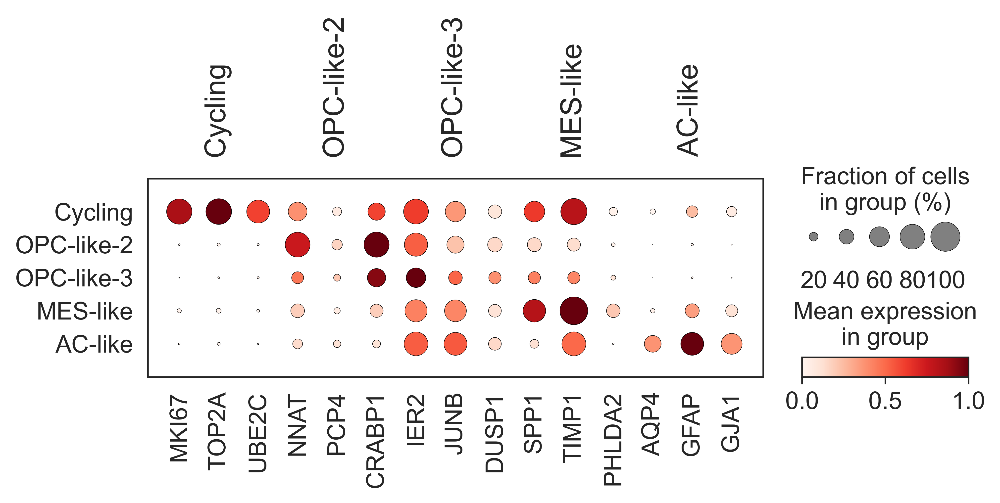

In [18]:
with plt.rc_context({"figure.figsize": (10,5), "figure.dpi": (300)}):
    sc.pl.dotplot(
        adata, 
        var_names=genes_dict,
        groupby='final_tumor_annot',
        categories_order=['Cycling','OPC-like-2','OPC-like-3','MES-like','AC-like'],
        standard_scale='group',
        show=False,
    )
    plt.savefig(os.path.join(fig_dir, "Dotplot_markers_final_tumor_annot.pdf"), bbox_inches="tight")

/scratch/30728543/ipykernel_1230540/1539208036.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df = adata.obs.groupby(["predicted.jessa_annotation", "final_tumor_annot"]).size().unstack(fill_value=0)


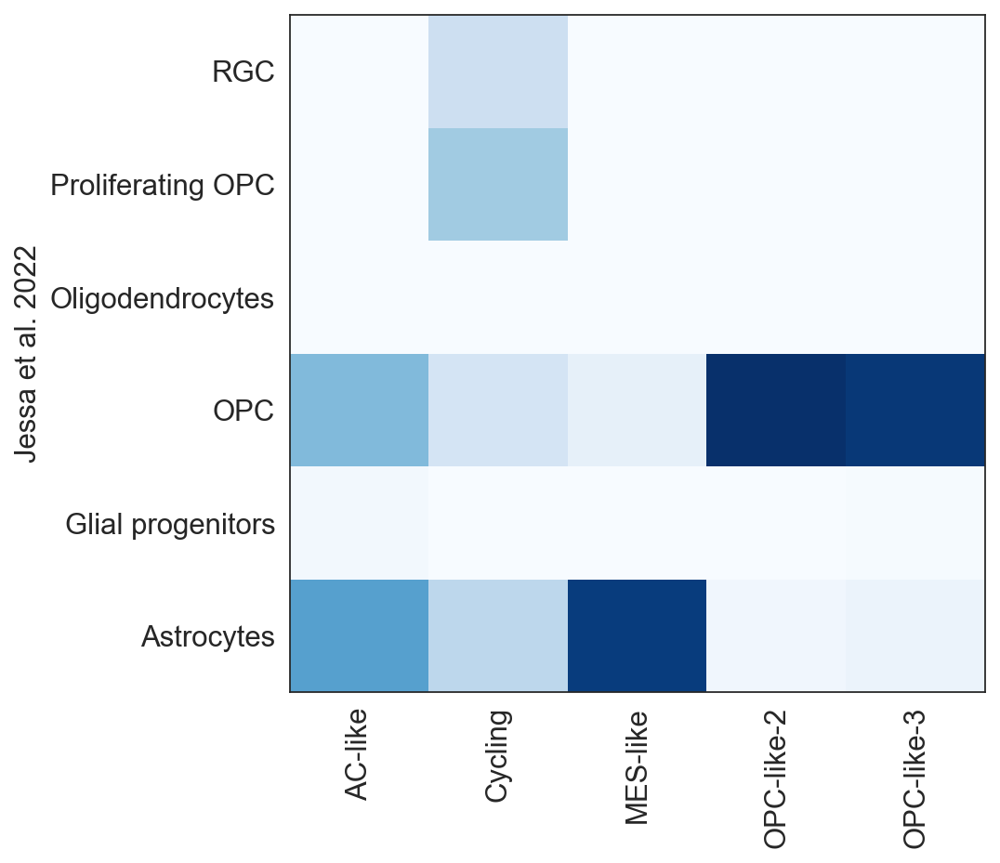

In [19]:
df = adata.obs.groupby(["predicted.jessa_annotation", "final_tumor_annot"]).size().unstack(fill_value=0)

norm_df = df / df.sum(axis=0)

plt.figure(figsize=(6, 6))
_ = plt.pcolor(norm_df, cmap='Blues', edgecolor='none')
_ = plt.xticks(np.arange(0.5, len(df.columns), 1), df.columns, rotation=90)
_ = plt.yticks(np.arange(0.5, len(df.index), 1), df.index)
_ = plt.grid(False)
plt.xlabel("")
plt.ylabel("Jessa et al. 2022")
plt.savefig(f'{fig_dir}BRO_RA1_matrixplot_jessa_tumor.pdf', bbox_inches='tight', dpi=300)
plt.show()

/scratch/30728543/ipykernel_1230540/1371357107.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df = adata.obs.groupby(["predicted.annotation", "final_tumor_annot"]).size().unstack(fill_value=0)


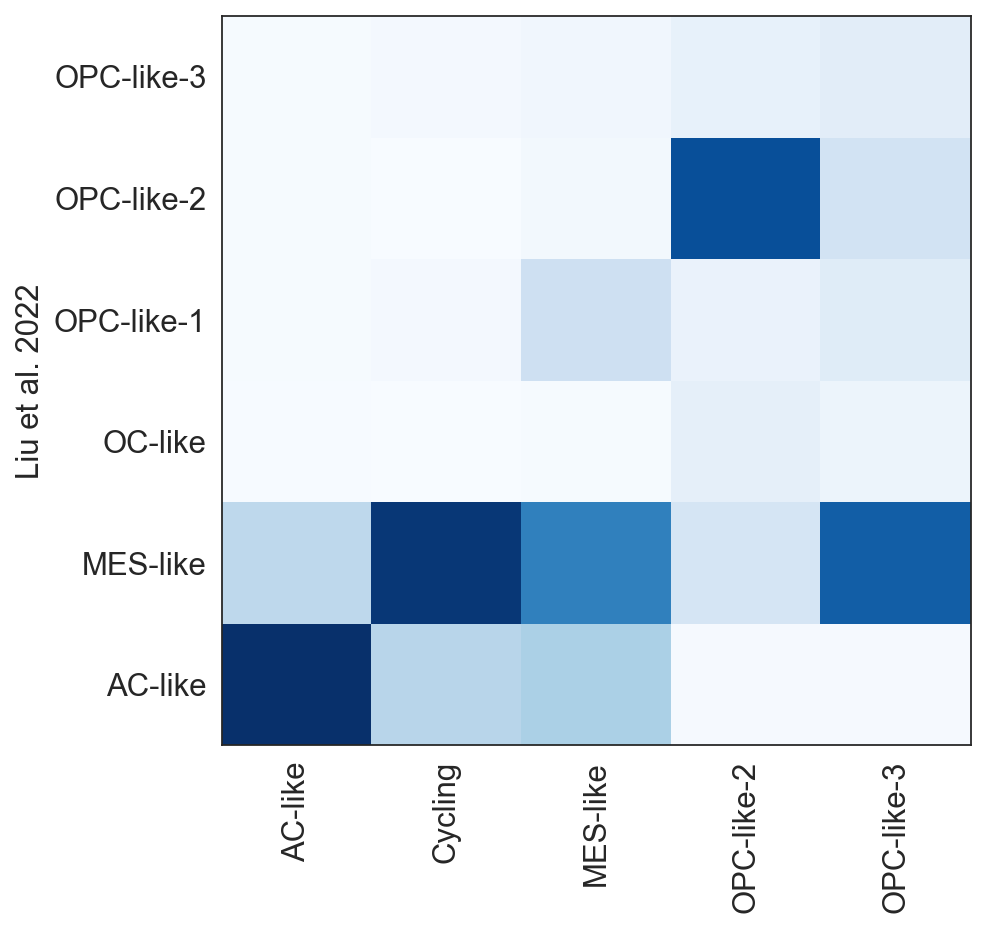

In [20]:
df = adata.obs.groupby(["predicted.annotation", "final_tumor_annot"]).size().unstack(fill_value=0)

norm_df = df / df.sum(axis=0)

plt.figure(figsize=(6, 6))
_ = plt.pcolor(norm_df, cmap='Blues', edgecolor='none')
_ = plt.xticks(np.arange(0.5, len(df.columns), 1), df.columns, rotation=90)
_ = plt.yticks(np.arange(0.5, len(df.index), 1), df.index)
_ = plt.grid(False)
plt.xlabel("")
plt.ylabel("Liu et al. 2022")
plt.savefig(f'{fig_dir}BRO_RA1_matrixplot_liu_tumor.pdf', bbox_inches='tight', dpi=300)
plt.show()

# Lineage tracing plots

In [9]:
adata = r(
    f"library(Seurat)\n"
    f"as.SingleCellExperiment(readRDS('{lineage_path}'), assay='RNA')\n"
)
adata

AnnData object with n_obs × n_vars = 4707 × 36607
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'sample', 'nCount_HTO', 'nFeature_HTO', 'percent.mito', 'percent.ribo', 'gender.score1', 'gender.score2', 'gender.score3', 'gender.score4', 'gender.score5', 'nCount_SCT', 'nFeature_SCT', 'seurat_clusters', 'DF.individual', 'DF.pANN.individual', 'G1.S.score_Neftel', 'G2.M.score_Neftel', 'S.Score', 'G2M.Score', 'Phase', 'source', 'RunID', 'tumor.score', 'gender.score', 'nCount_prediction.score.type', 'nFeature_prediction.score.type', 'RunID.sample', 'RunID.source', 'sample.source', 'RNA_snn_res.0.4', 'RNA_snn_res.0.8', 'RNA_snn_res.1.2', 'names', 'tumor.plasmids', 'tumor.plasmids.malignancy.25', 'Mapping.score.Liu', 'predicted.id.Liu', 'predicted.id.score.Liu', 'cNMF_program_1', 'cNMF_program_2', 'cNMF_program_3', 'cNMF_program_4', 'cNMF_program_5', 'cNMF_program_6', 'cNMF_program_7', 'cNMF_program_8', 'NMF_max', 'predicted.id.Braun', 'final_tumor_annot', 'ident'
    obsm: 'X_pca', 'X_u

In [10]:
jaccard_similarity = compute_jaccard_similarity(adata, 'NMF_max', 'final_tumor_annot')
print(jaccard_similarity)

                MES-like  OPC-like-2   Cycling   AC-like  OPC-like-3  None
cNMF_program_5  0.362205    0.000000  0.082071  0.030534    0.000836   0.0
cNMF_program_2  0.003590    0.463061  0.013274  0.002966    0.041265   0.0
cNMF_program_3  0.266895    0.029986  0.122510  0.102541    0.039688   0.0
cNMF_program_1  0.000491    0.424331  0.001190  0.000565    0.124514   0.0
cNMF_program_7  0.001006    0.000000  0.453515  0.000000    0.000000   0.0
cNMF_program_4  0.016787    0.004181  0.000000  0.034979    0.486998   0.0
cNMF_program_8  0.151478    0.000868  0.006932  0.009050    0.006557   0.0
cNMF_program_6  0.006014    0.000000  0.031566  0.604610    0.003469   0.0


In [11]:
jaccard_similarity = jaccard_similarity.sort_index()
jaccard_similarity = jaccard_similarity.drop('None', axis=1)
jaccard_similarity = jaccard_similarity[["OPC-like-2","OPC-like-3","MES-like","AC-like","Cycling"]]

In [13]:
cmap_reds = plt.get_cmap('Reds')
num_colors = 256
colors = ['white'] + [cmap_reds(i / num_colors) for i in range(2, num_colors)]
cmap = LinearSegmentedColormap.from_list('', colors, num_colors)

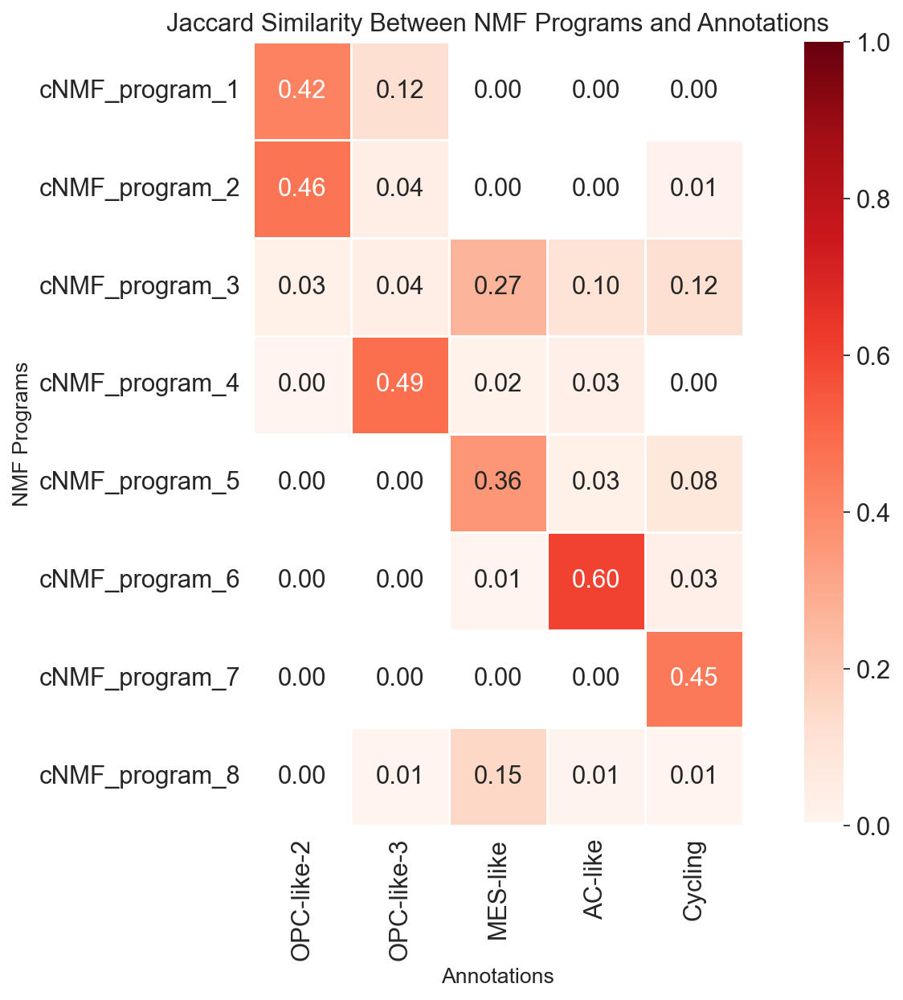

In [14]:
plt.figure(figsize=(10, 8))
sns.heatmap(jaccard_similarity, annot=True, fmt=".2f", cmap=cmap, cbar=True, square=True, linewidths=.5, vmax=1)

# Add titles and labels
plt.title("Jaccard Similarity Between NMF Programs and Annotations", fontsize=14)
plt.xlabel("Annotations", fontsize=12)
plt.ylabel("NMF Programs", fontsize=12)

# Show the plot
plt.tight_layout()
plt.savefig(f'{fig_dir}lineage_jaccard_index.pdf', bbox_inches='tight', dpi=300)
plt.show()